#### In this notebook my focus to work upon columns :
1. Area with type
2. Additional room
3. Age possession
4. Furnish details
5. Features

In [180]:
import numpy as np
import pandas as pd
import re

In [181]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [182]:
df = pd.read_csv('gurgaon_properties_cleaned_v1.csv')

In [183]:
df

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features
0,flat,la vida by tata housing,sector 113,3.05,15561.0,1960.0,Super Built up area 2690(249.91 sq.m.)Built Up area: 2150 sq.ft. (199.74 sq.m.)Carpet area: 1960 sq.ft. (182.09 sq.m.),3,4,3,servant room,3.0,North-West,1 to 5 Year Old,"['Dwarka Sector 21', 'Pacific D21 Mall', 'Bajghera Road', 'Dwarka Expy', 'Euro International School, Sector- 109.', 'The NorthCap University', ""Rion's Hospital"", 'Indira Gandhi Intl Airport', 'Bijwasan Railway Station']","['1 Geyser', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
1,flat,m3m woodshire,sector 107,0.88,6442.0,1366.0,Super Built up area 1366(126.91 sq.m.),2,2,3+,not available,3.0,East,1 to 5 Year Old,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']","['1 Bed', '5 Fan', '1 Sofa', '10 Light', '3 AC', '1 Curtains', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'No open drainage around', 'Recently Renovated', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']"
2,house,vatika india next,sector 82,7.00,194444.0,360.0,Plot area 360(33.45 sq.m.)Built Up area: 3900 sq.ft. (362.32 sq.m.)Carpet area: 3743 sq.ft. (347.74 sq.m.),4,4,3+,servant room,3.0,North-East,1 to 5 Year Old,"['Sapphire 83 Mall', 'Dwarka expressway', 'Delhi Public School', 'Miracles Apollo Hospital', 'IGI Airport', 'Garhi Harsaru Junction', 'Hyatt Regency Hotel', 'Cricket academy']","['1 Water Purifier', '8 Fan', '1 Fridge', '1 Exhaust Fan', '1 Dining Table', '5 Geyser', '1 Stove', '7 Light', '8 AC', '1 Chimney', '3 TV', '1 Curtains', '1 Modular Kitchen', '4 Wardrobe', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No Bed']","['Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Low Density Society', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center']"
3,house,independent,sector 12,1.40,8702.0,1609.0,Plot area 166(138.8 sq.m.),2,2,1,not available,2.0,North-East,10+ Year Old,"['Ravi Clinic and Health Care Centre', 'D.R. Rajnis Gupta Clinic', 'Geeta Nursing Home Gurgaon', 'Bindal Clinic', 'Aryan Hospital', 'Bhatnagar Maternity and Nursing Home', 'Sparsh Hospital Gurgaon', 'M.S Hospital', 'Triveni Hospital Gurgaon', 'My Care Clinic', 'Chiranjiv Hospital', 'Dr. Sarvejeet Si

In [184]:
df.duplicated().sum()

122

# 1. Area With Type

In the realm of real estate, there exist three distinct types of area measurements:

    1. Super Built- up Area:
        This encompasses the built-up area, along with additional spaces such as car parking areas and common 
        areas adjacent to the lift.
    2. Built-up Area:
        Comprising the internal living space,  the thickness of walls, and the area of balconies, 
        the built-up area reflects the entirety of a home's enclosed space.
    3. Carpet Area:
        Focusing solely on the internal living space, the carpet area disregards walls and balconies.
    4. Plot Area:
        Specifically applicable to independent houses, the plot area denotes the entire land area on which the 
        house is constructed. In such cases, there is no super built-up area, 
        and the emphasis is on the plot area.
        

In [185]:
df.sample(5)[['price','area','areaWithType']]

,price,area,areaWithType
2217,0.49,436.0,Plot area 360(33.45 sq.m.)
3452,2.25,2100.0,Carpet area: 2100 (195.1 sq.m.)
3684,0.80,546.0,Carpet area: 546 (50.73 sq.m.)
2454,0.21,484.0,Built Up area: 484 (44.97 sq.m.)
1557,1.92,1250.0,Carpet area: 1250 (116.13 sq.m.)


Observations:-
    
- The "areaWithType" column currently contains a mix of different area types without clear distinctions, making it 
challenging to utilize. To address this i will create three seperate columns "Super Built-up Area", "Built-up Area",
and "Carpet Area".
- Additionally, the area values occasionally include units such as "square meter", "square yard" or "square feet". 
To ensure uniformity, I plan to convert all these values into square feet for consistency.

In [186]:
# this function extracts the Super Built-up Area

def get_super_built_up_area(text):
    match = re.search(r'Super Built up area (\d+\.?\d*)',text)
    if match:
        return float(match.group(1))
    return None
        

In [187]:
# this function extracts the Built-up Area or Carpet Area

def get_area(text, area_type):
    match = re.search(area_type + r'\s*:\s*(\d+\.?\d*)',text)
    if match:
        return float(match.group(1))
    return None

In [188]:
# this function checks if the area is provided in sq.m. and converts it to sqft if needed 

def convert_to_sqft(text,area_value):
    if area_value is None:
        return None
    match = re.search(r'{} \((\d+\.?\d*) sq.m.\)'.format(area_value),text)
    if match :
        sq_m_value = float(match.group(1))
        return sq_m_value *10.7639  #conversion factor from sq.m. to sqft
    return area_value

In [189]:
# Extract Super Built up area and convert to sqft if needed
df['super_built_up_area'] = df['areaWithType'].apply(get_super_built_up_area)
df['super_built_up_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['super_built_up_area']), axis=1)

# Extract Built Up area and convert to sqft if needed
df['built_up_area'] = df['areaWithType'].apply(lambda x: get_area(x, 'Built Up area'))
df['built_up_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['built_up_area']), axis=1)

# Extract Carpet area and convert to sqft if needed
df['carpet_area'] = df['areaWithType'].apply(lambda x: get_area(x, 'Carpet area'))
df['carpet_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['carpet_area']), axis=1)

In [190]:
df[['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].sample(5)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
324,1.68,flat,1668.0,Super Built up area 1668(154.96 sq.m.),1668.0,NaN,NaN
246,2.45,flat,1551.0,Super Built up area 1549(143.91 sq.m.)Carpet area: 939.37 sq.ft. (87.27 sq.m.),1549.0,NaN,939.37
3780,0.85,flat,1081.0,Super Built up area 1081(100.43 sq.m.)Built Up area: 1080 sq.ft. (100.34 sq.m.)Carpet area: 670 sq.ft. (62.25 sq.m.),1081.0,1080.0,670.00
2079,1.02,flat,1260.0,Super Built up area 1260(117.06 sq.m.)Built Up area: 1250 sq.ft. (116.13 sq.m.)Carpet area: 800 sq.ft. (74.32 sq.m.),1260.0,1250.0,800.00
2710,0.90,flat,1950.0,Super Built up area 1950(181.16 sq.m.),1950.0,NaN,NaN


In [191]:
df.duplicated().sum()

122

In [192]:
df[~((df['super_built_up_area'].isnull()) | (df['built_up_area'].isnull()) | (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
0,3.05,flat,1960.0,Super Built up area 2690(249.91 sq.m.)Built Up area: 2150 sq.ft. (199.74 sq.m.)Carpet area: 1960 sq.ft. (182.09 sq.m.),2690.0,2150.00,1960.00
5,1.50,flat,2000.0,Super Built up area 2000(185.81 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.)Carpet area: 1800 sq.ft. (167.23 sq.m.),2000.0,1900.00,1800.00
10,1.69,flat,1976.0,Super Built up area 1976(183.58 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.)Carpet area: 1650 sq.ft. (153.29 sq.m.),1976.0,1900.00,1650.00
18,1.85,flat,2150.0,Super Built up area 2150(199.74 sq.m.)Built Up area: 1650 sq.ft. (153.29 sq.m.)Carpet area: 1350 sq.ft. (125.42 sq.m.),2150.0,1650.00,1350.00
30,1.60,flat,1910.0,Super Built up area 1910(177.44 sq.m.)Built Up area: 1700 sq.ft. (157.94 sq.m.)Carpet area: 1600 sq.ft. (148.64 sq.m.),1910.0,1700.00,1600.00
35,3.00,flat,2100.0,Super Built up area 2691(250 sq.m.)Built Up area: 2460 sq.ft. (228.54 sq.m.)Carpet area: 2100 sq.ft. (195.1 sq.m.),2691.0,2460.00,2100.00
40,6.20,flat,2685.0,Super Built up area 2685(249.44 sq.m.)Built Up area: 2000 sq.ft. (185.81 sq.m.)Carpet area: 1900 sq.ft. (176.52 sq.m.),2685.0,2000.00,1900.00
44,1.83,flat,2290.0,Super Built up area 2290(212.75 sq.m.)Built Up area: 2000 sq.ft. (185.81 sq.m.)Carpet area: 1750 sq.ft. (162.58 sq.m.),2290.0,2000.00,1750.00
46,1.35,flat,1850.0,Super Built up area 2355(218.79 sq.m.)Built Up area: 2100 sq.ft. (195.1 sq.m.)Carpet area: 1850 sq.ft. (171.87 sq.m.),2355.0,2100.00,1850.00
57,0.90,flat,1986.0,Super Built up area 1975(183.48 sq.m.)Built Up area: 1575 sq.ft. (146.32 sq.m.)Carpet area: 1435 sq.ft. (133.32 sq.m.),1975.0,1575.00,1435.00


In [193]:
df[~((df['super_built_up_area'].isnull()) | (df['built_up_area'].isnull()) | (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].shape

(534, 7)

- Out of 3800 flat in 534 flats we have entire value available for "super built up area", "carpet area", "built up area"

In [194]:
# extracting "plot area" from areaWithType column
df[df['areaWithType'].str.contains('Plot')][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
2,7.00,house,360.0,Plot area 360(33.45 sq.m.)Built Up area: 3900 sq.ft. (362.32 sq.m.)Carpet area: 3743 sq.ft. (347.74 sq.m.),NaN,3900.0,3743.0
3,1.40,house,1609.0,Plot area 166(138.8 sq.m.),NaN,NaN,NaN
13,8.50,house,4770.0,Plot area 530(443.15 sq.m.),NaN,NaN,NaN
15,3.10,house,1548.0,Plot area 172(143.81 sq.m.),NaN,NaN,NaN
23,8.49,house,1800.0,Plot area 200(167.23 sq.m.),NaN,NaN,NaN
24,6.50,house,1800.0,Plot area 200(167.23 sq.m.),NaN,NaN,NaN
26,9.50,house,4050.0,Plot area 502(419.74 sq.m.)Built Up area: 500 sq.yards (418.06 sq.m.)Carpet area: 450 sq.yards (376.26 sq.m.),NaN,500.0,450.0
29,0.50,house,900.0,Plot area 900(83.61 sq.m.),NaN,NaN,NaN
34,3.60,house,1728.0,Plot area 192(160.54 sq.m.),NaN,NaN,NaN
47,3.49,house,1728.0,Plot area 192(160.54 sq.m.),NaN,NaN,NaN


In [195]:
df[df['areaWithType'].str.contains('Plot')][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].shape

(682, 7)

- Out of 3800 flat in "682" rows we have plot area detail given.

In [196]:
# checking missing value in "super built up area", "built up area" and "carpet area" 

df.isnull().sum()

property_type             0
society                   1
sector                    0
price                    18
price_per_sqft           18
area                     18
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 19
facing                 1105
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
built_up_area          2616
carpet_area            1859
dtype: int64

- I have isolated the rows where all three area types, namely "Super Built-up Area", "Built-up Area", and "Carpet Area",
have missing values. These rows have been collated into a new DataFrame named "all_nan_df"

In [197]:
 df[df['super_built_up_area'].isnull()].shape

(1888, 20)

In [198]:
all_nan_df = df[((df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

In [199]:
all_nan_df.head()

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
3,1.40,house,1609.0,Plot area 166(138.8 sq.m.),NaN,NaN,NaN
13,8.50,house,4770.0,Plot area 530(443.15 sq.m.),NaN,NaN,NaN
15,3.10,house,1548.0,Plot area 172(143.81 sq.m.),NaN,NaN,NaN
23,8.49,house,1800.0,Plot area 200(167.23 sq.m.),NaN,NaN,NaN
24,6.50,house,1800.0,Plot area 200(167.23 sq.m.),NaN,NaN,NaN


- identify the index values corresponding to the rows with missing values in "Super Built-up Area", "Built-up Area", and 
"Carpet Area", and store them in a variable named "all_nan_index"

In [200]:
all_nan_index = df[((df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].index

- Discovered cases where only "plot area" values were provided, leaving the "Super Built-up Area", "Built-up Area",
and "Carpet Area" columns empty. To address this, a function called "extract_plot_area" has been created.
- This function fills the "Built-up Area" column with the corresponding "Plot area" values extracted from the "Area with type" column.

In [201]:
# Function to extract plot area from 'areaWithType' column
def extract_plot_area(area_with_type):
    match = re.search(r'Plot area (\d+\.?\d*)', area_with_type)
    return float(match.group(1)) if match else None

In [202]:
all_nan_df['built_up_area'] = all_nan_df['areaWithType'].apply(extract_plot_area)

In [203]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
3,1.40,house,1609.0,Plot area 166(138.8 sq.m.),NaN,166.00,NaN
13,8.50,house,4770.0,Plot area 530(443.15 sq.m.),NaN,530.00,NaN
15,3.10,house,1548.0,Plot area 172(143.81 sq.m.),NaN,172.00,NaN
23,8.49,house,1800.0,Plot area 200(167.23 sq.m.),NaN,200.00,NaN
24,6.50,house,1800.0,Plot area 200(167.23 sq.m.),NaN,200.00,NaN
29,0.50,house,900.0,Plot area 900(83.61 sq.m.),NaN,900.00,NaN
34,3.60,house,1728.0,Plot area 192(160.54 sq.m.),NaN,192.00,NaN
47,3.49,house,1728.0,Plot area 192(160.54 sq.m.),NaN,192.00,NaN
58,1.50,house,1300.0,Plot area 1300(120.77 sq.m.),NaN,1300.00,NaN
67,1.45,house,540.0,Plot area 60(50.17 sq.m.),NaN,60.00,NaN


- Developed a function named "convert_scale" to address variations in area units.
- when the area value is divided by the "built-up area", the function interprets the results:
    - if the output is "9", it signifies that the value are in "square yards".
    - if the output is "11", it indicates that the value are in "square meters".
    - if the output is "1", it denotes that the value are already in "square feet".

- This function facilitates the conversion of area values into a consistent unit, whether in square yards, square meters
, or square feet.

In [204]:
def convert_scale(row):
    if np.isnan(row['area']) or np.isnan(row['built_up_area']):
        return row['built_up_area']
    else:
        if round(row['area']/row['built_up_area']) == 9.0:
            return row['built_up_area'] * 9
        elif round(row['area']/row['built_up_area']) == 11.0:
            return row['built_up_area'] * 10.7
        else:
            return row['built_up_area']

In [205]:
all_nan_df['built_up_area'] = all_nan_df.apply(convert_scale,axis=1)

In [206]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
3,1.40,house,1609.0,Plot area 166(138.8 sq.m.),NaN,166.00,NaN
13,8.50,house,4770.0,Plot area 530(443.15 sq.m.),NaN,4770.00,NaN
15,3.10,house,1548.0,Plot area 172(143.81 sq.m.),NaN,1548.00,NaN
23,8.49,house,1800.0,Plot area 200(167.23 sq.m.),NaN,1800.00,NaN
24,6.50,house,1800.0,Plot area 200(167.23 sq.m.),NaN,1800.00,NaN
29,0.50,house,900.0,Plot area 900(83.61 sq.m.),NaN,900.00,NaN
34,3.60,house,1728.0,Plot area 192(160.54 sq.m.),NaN,1728.00,NaN
47,3.49,house,1728.0,Plot area 192(160.54 sq.m.),NaN,1728.00,NaN
58,1.50,house,1300.0,Plot area 1300(120.77 sq.m.),NaN,1300.00,NaN
67,1.45,house,540.0,Plot area 60(50.17 sq.m.),NaN,540.00,NaN


In [207]:
# update the original dataframe
df.update(all_nan_df)

In [208]:
df.isnull().sum()

property_type             0
society                   1
sector                    0
price                    18
price_per_sqft           18
area                     18
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 19
facing                 1105
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
built_up_area          2070
carpet_area            1859
dtype: int64

In [209]:
df.head()

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
0,flat,la vida by tata housing,sector 113,3.05,15561.0,1960.0,Super Built up area 2690(249.91 sq.m.)Built Up area: 2150 sq.ft. (199.74 sq.m.)Carpet area: 1960 sq.ft. (182.09 sq.m.),3,4,3,servant room,3.0,North-West,1 to 5 Year Old,"['Dwarka Sector 21', 'Pacific D21 Mall', 'Bajghera Road', 'Dwarka Expy', 'Euro International School, Sector- 109.', 'The NorthCap University', ""Rion's Hospital"", 'Indira Gandhi Intl Airport', 'Bijwasan Railway Station']","['1 Geyser', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2690.0,2150.0,1960.0
1,flat,m3m woodshire,sector 107,0.88,6442.0,1366.0,Super Built up area 1366(126.91 sq.m.),2,2,3+,not available,3.0,East,1 to 5 Year Old,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']","['1 Bed', '5 Fan', '1 Sofa', '10 Light', '3 AC', '1 Curtains', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'No open drainage around', 'Recently Renovated', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1366.0,NaN,NaN
2,house,vatika india next,sector 82,7.00,194444.0,360.0,Plot area 360(33.45 sq.m.)Built Up area: 3900 sq.ft. (362.32 sq.m.)Carpet area: 3743 sq.ft. (347.74 sq.m.),4,4,3+,servant room,3.0,North-East,1 to 5 Year Old,"['Sapphire 83 Mall', 'Dwarka expressway', 'Delhi Public School', 'Miracles Apollo Hospital', 'IGI Airport', 'Garhi Harsaru Junction', 'Hyatt Regency Hotel', 'Cricket academy']","['1 Water Purifier', '8 Fan', '1 Fridge', '1 Exhaust Fan', '1 Dining Table', '5 Geyser', '1 Stove', '7 Light', '8 AC', '1 Chimney', '3 TV', '1 Curtains', '1 Modular Kitchen', '4 Wardrobe', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No Bed']","['Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Low Density Society', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center']",NaN,3900.0,3743.0
3,house,independent,sector 12,1.40,8702.0,1609.0,Plot area 166(138.8 sq.m.),2,2,1,not available,2.0,North-East,10+ Year Old,"['Ravi Clinic and Health Care Centre', 'D.R. Rajnis Gupta Clinic', 'Geeta Nursing Home Gurgaon', 'Bindal Clinic', 'Aryan Hospital', 'Bhatnagar Maternity and Nursing Home', 'Sparsh Hospital Gurgaon', '

# 2. Additional Room

In [210]:
df['additionalRoom'].value_counts()

additionalRoom
not available                                    1587
servant room                                      705
study room                                        250
others                                            225
pooja room                                        165
study room,servant room                            99
store room                                         99
pooja room,servant room                            82
pooja room,study room,servant room,store room      72
servant room,others                                60
pooja room,study room,servant room                 55
pooja room,study room,servant room,others          54
servant room,pooja room                            38
servant room,store room                            33
study room,others                                  29
pooja room,study room                              22
pooja room,others                                  17
pooja room,store room                              15
servant room,

Observation:-
    
- During the preprocessing phase, all null values have been converted to "Not Available"
- In the "additional room" column, there are five types of additional room information provided: Servant Room, 
    Pooja Room, Study Room, Store Room, and Other Room.
- To enhance the representation of this data, I will create five new columns using "One Hot Encoding" : "Servant",
    "Pooja", "Study", "Store", and "Others".
- if the value is "Not Available", all new columns will be filled with "0".
- If the property has a servant room, the "Servant"  column will be filled with "1", and the rest will be filled with "0".
- In cases where there is a combination of additional room information, the respective columns will be filled with "1", 
and others will be filled with "0".

In [211]:
# additional room
# list of new columns to be created

new_cols = ['study room', 'servant room', 'store room', 'pooja room', 'others']

# populate the new columns based on the "additional column"

for col in new_cols:
    df[col] = df['additionalRoom'].str.contains(col).astype(int)

In [212]:
df.sample(5)[['additionalRoom','study room', 'servant room', 'store room', 'pooja room', 'others']]

,additionalRoom,study room,servant room,store room,pooja room,others
2697,servant room,0,1,0,0,0
1077,not available,0,0,0,0,0
3370,"study room,servant room",1,1,0,0,0
2062,not available,0,0,0,0,0
2588,not available,0,0,0,0,0


In [213]:
df.head()

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,pooja room,others
0,flat,la vida by tata housing,sector 113,3.05,15561.0,1960.0,Super Built up area 2690(249.91 sq.m.)Built Up area: 2150 sq.ft. (199.74 sq.m.)Carpet area: 1960 sq.ft. (182.09 sq.m.),3,4,3,servant room,3.0,North-West,1 to 5 Year Old,"['Dwarka Sector 21', 'Pacific D21 Mall', 'Bajghera Road', 'Dwarka Expy', 'Euro International School, Sector- 109.', 'The NorthCap University', ""Rion's Hospital"", 'Indira Gandhi Intl Airport', 'Bijwasan Railway Station']","['1 Geyser', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2690.0,2150.0,1960.0,0,1,0,0,0
1,flat,m3m woodshire,sector 107,0.88,6442.0,1366.0,Super Built up area 1366(126.91 sq.m.),2,2,3+,not available,3.0,East,1 to 5 Year Old,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']","['1 Bed', '5 Fan', '1 Sofa', '10 Light', '3 AC', '1 Curtains', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'No open drainage around', 'Recently Renovated', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1366.0,NaN,NaN,0,0,0,0,0
2,house,vatika india next,sector 82,7.00,194444.0,360.0,Plot area 360(33.45 sq.m.)Built Up area: 3900 sq.ft. (362.32 sq.m.)Carpet area: 3743 sq.ft. (347.74 sq.m.),4,4,3+,servant room,3.0,North-East,1 to 5 Year Old,"['Sapphire 83 Mall', 'Dwarka expressway', 'Delhi Public School', 'Miracles Apollo Hospital', 'IGI Airport', 'Garhi Harsaru Junction', 'Hyatt Regency Hotel', 'Cricket academy']","['1 Water Purifier', '8 Fan', '1 Fridge', '1 Exhaust Fan', '1 Dining Table', '5 Geyser', '1 Stove', '7 Light', '8 AC', '1 Chimney', '3 TV', '1 Curtains', '1 Modular Kitchen', '4 Wardrobe', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No Bed']","['Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Low Density Society', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center']",NaN,3900.0,3743.0,0,1,0,0,0
3,house,independent,sector 12,1.40,8702.0,1609.0,Plot area 166(138.8 sq.m.),2,2,1,not available,2.0,North-East,10+ Year Old,"['Ravi Clinic and Health Care Centre', 'D.R. Rajnis Gupta Clinic', 'Geeta Nursing Home Gurgaon', 'Bindal Clinic', 'Ar

# 3. Age Possession 

In [214]:
df['agePossession'].value_counts()

agePossession
1 to 5 Year Old       1676
5 to 10 Year Old       575
0 to 1 Year Old        530
undefined              332
10+ Year Old           310
Under Construction      90
Within 6 months         70
Within 3 months         26
Dec 2023                22
By 2023                 19
By 2024                 17
Dec 2024                16
Mar 2024                14
Oct 2024                 8
Jan 2024                 8
Aug 2023                 7
Dec 2025                 7
Jun 2024                 7
Nov 2023                 5
Jul 2024                 4
Sep 2023                 4
By 2025                  4
Oct 2023                 4
Aug 2024                 4
Jan 2025                 3
May 2024                 3
Feb 2024                 3
Nov 2024                 3
By 2027                  2
Jun 2027                 2
Mar 2025                 2
Oct 2025                 2
Apr 2026                 2
Jan 2026                 2
Aug 2025                 2
Jul 2027                 2
Jul 2025      

Observations:-
    
- In this particular column, there are numerous categories, including ranges, specific years, and some enteries 
labeled as "undefined". To organize and classify this data, i've implemented a function utilizing "if-else" conditions.
- The function categorizes the properties as follows:
    - if the property is "0 to 1 year old", "within 6 months", or "within 3 months", it is labeled as "New Property"
    - For properties aged "1 to 5 years", they are categorized as "Relativiely New"
    - Properties aged "5 to 10 years" fall under the classification of "Moderately Old"
    - For properties aged "10+years", they are designated as "Old Property"
    - If the property is "Under Construction", it is marked as "Under Construction"
    - In all other cases, the function returns "undefined"

In [215]:
def categorize_age_possession(value):
    if pd.isna(value):
        return "Undefined"
    if "0 to 1 Year Old" in value or "Within 6 months" in value or "Within 3 months" in value:
        return "New Property"
    if "1 to 5 Year Old" in value:
        return "Relatively New"
    if "5 to 10 Year Old" in value:
        return "Moderately Old"
    if "10+ Year Old" in value:
        return "Old Property"
    if "Under Construction" in value or "By" in value:
        return "Under Construction"
    try:
        # For entries like 'May 2024'
        int(value.split(" ")[-1])
        return "Under Construction"
    except:
        return "Undefined"

In [216]:
df['agePossession'] = df['agePossession'].apply(categorize_age_possession)

In [217]:
df['agePossession'].value_counts()

agePossession
Relatively New        1676
New Property           626
Moderately Old         575
Undefined              333
Old Property           310
Under Construction     283
Name: count, dtype: int64

- This process has effectively reduced the initial 50 categories within the column to a more streamlined classifiacition,
resulting in a total of 6 distinct categories.

In [218]:
df.head()

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,pooja room,others
0,flat,la vida by tata housing,sector 113,3.05,15561.0,1960.0,Super Built up area 2690(249.91 sq.m.)Built Up area: 2150 sq.ft. (199.74 sq.m.)Carpet area: 1960 sq.ft. (182.09 sq.m.),3,4,3,servant room,3.0,North-West,Relatively New,"['Dwarka Sector 21', 'Pacific D21 Mall', 'Bajghera Road', 'Dwarka Expy', 'Euro International School, Sector- 109.', 'The NorthCap University', ""Rion's Hospital"", 'Indira Gandhi Intl Airport', 'Bijwasan Railway Station']","['1 Geyser', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2690.0,2150.0,1960.0,0,1,0,0,0
1,flat,m3m woodshire,sector 107,0.88,6442.0,1366.0,Super Built up area 1366(126.91 sq.m.),2,2,3+,not available,3.0,East,Relatively New,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']","['1 Bed', '5 Fan', '1 Sofa', '10 Light', '3 AC', '1 Curtains', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'No open drainage around', 'Recently Renovated', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1366.0,NaN,NaN,0,0,0,0,0
2,house,vatika india next,sector 82,7.00,194444.0,360.0,Plot area 360(33.45 sq.m.)Built Up area: 3900 sq.ft. (362.32 sq.m.)Carpet area: 3743 sq.ft. (347.74 sq.m.),4,4,3+,servant room,3.0,North-East,Relatively New,"['Sapphire 83 Mall', 'Dwarka expressway', 'Delhi Public School', 'Miracles Apollo Hospital', 'IGI Airport', 'Garhi Harsaru Junction', 'Hyatt Regency Hotel', 'Cricket academy']","['1 Water Purifier', '8 Fan', '1 Fridge', '1 Exhaust Fan', '1 Dining Table', '5 Geyser', '1 Stove', '7 Light', '8 AC', '1 Chimney', '3 TV', '1 Curtains', '1 Modular Kitchen', '4 Wardrobe', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No Bed']","['Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Low Density Society', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center']",NaN,3900.0,3743.0,0,1,0,0,0
3,house,independent,sector 12,1.40,8702.0,1609.0,Plot area 166(138.8 sq.m.),2,2,1,not available,2.0,North-East,Old Property,"['Ravi Clinic and Health Care Centre', 'D.R. Rajnis Gupta Clinic', 'Geeta Nursing Home Gurgaon', 'Bindal Clinic', 'Aryan

# 4. Furnish Details

In [219]:
df['furnishDetails'].value_counts()

furnishDetails
[]                                                                                                                                                                                                                                                                       421
['1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']     199
['1 Modular Kitchen', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']      72
['1 Wardrobe', '1 Fan', '1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fri

Observations:-
    
- There are total 18 unique categories given.
    

In [220]:
# Extract all unique furnishings from the furnishDetails column

all_furnishings = []
for detail in df['furnishDetails'].dropna():
    furnishings = detail.replace('[', '').replace(']', '').replace("'", "").split(', ')
    all_furnishings.extend(furnishings)
unique_furnishings = list(set(all_furnishings))

In [221]:
# Define a function to extract the count of a furnishing from the furnishDetails

def get_furnishing_count(details, furnishing):
    if isinstance(details, str):
        if f"No {furnishing}" in details:
            return 0
        pattern = re.compile(f"(\d+) {furnishing}")
        match = pattern.search(details)
        if match:
            return int(match.group(1))
        elif furnishing in details:
            return 1
    return 0

In [222]:
# Simplify the furnishings list by removing "No" prefix and numbers

columns_to_include = [re.sub(r'No |\d+', '', furnishing).strip() for furnishing in unique_furnishings]
columns_to_include = list(set(columns_to_include))  # Get unique furnishings
columns_to_include = [furnishing for furnishing in columns_to_include if furnishing]  # Remove empty strings

In [223]:
# Create new columns for each unique furnishing and populate with counts

for furnishing in columns_to_include:
    df[furnishing] = df['furnishDetails'].apply(lambda x: get_furnishing_count(x, furnishing))

In [224]:
# Create the new dataframe with the required columns

furnishings_df = df[['furnishDetails'] + columns_to_include]

In [225]:
furnishings_df

,furnishDetails,TV,Water Purifier,Curtains,Chimney,Washing Machine,Wardrobe,AC,Fan,Modular Kitchen,Dining Table,Light,Stove,Fridge,Geyser,Exhaust Fan,Sofa,Microwave,Bed
0,"['1 Geyser', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1,"['1 Bed', '5 Fan', '1 Sofa', '10 Light', '3 AC', '1 Curtains', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0,0,1,0,0,0,3,5,0,0,10,0,0,0,0,1,0,1
2,"['1 Water Purifier', '8 Fan', '1 Fridge', '1 Exhaust Fan', '1 Dining Table', '5 Geyser', '1 Stove', '7 Light', '8 AC', '1 Chimney', '3 TV', '1 Curtains', '1 Modular Kitchen', '4 Wardrobe', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No Bed']",3,1,1,1,1,4,8,8,1,1,7,1,1,5,1,1,1,0
3,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,[],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,"['4 Fan', '1 Exhaust Fan', '3 Geyser', '29 Light', '1 Chimney', '1 Modular Kitchen', '4 Wardrobe', 'No AC', 'No Bed', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",0,0,0,1,0,4,0,4,1,0,29,0,0,3,1,0,0,0
6,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,"['3 Fan', '4 Light', '4 AC', '1 Modular Kitchen', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0,0,0,0,0,0,4,3,1,0,4,0,0,0,0,0,0,0
9,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [226]:
furnishings_df.shape

(3803, 19)

In [227]:
furnishings_df.drop(columns=['furnishDetails'],inplace=True)

/tmp/ipykernel_59412/114705885.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  furnishings_df.drop(columns=['furnishDetails'],inplace=True)


In [228]:
furnishings_df.sample(5)

,TV,Water Purifier,Curtains,Chimney,Washing Machine,Wardrobe,AC,Fan,Modular Kitchen,Dining Table,Light,Stove,Fridge,Geyser,Exhaust Fan,Sofa,Microwave,Bed
2209,0,0,1,0,0,4,4,5,1,0,10,0,0,0,1,0,0,0
2757,0,0,0,1,0,2,0,0,1,0,4,0,0,0,1,0,0,0
85,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
326,0,0,0,1,0,6,4,0,1,0,0,1,0,0,0,0,0,0
2100,0,0,1,1,0,3,2,5,1,0,14,0,0,3,1,0,0,0


In [229]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [230]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(furnishings_df)

In [231]:
wcss_reduced = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(scaled_data)
    wcss_reduced.append(kmeans.inertia_)

/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of

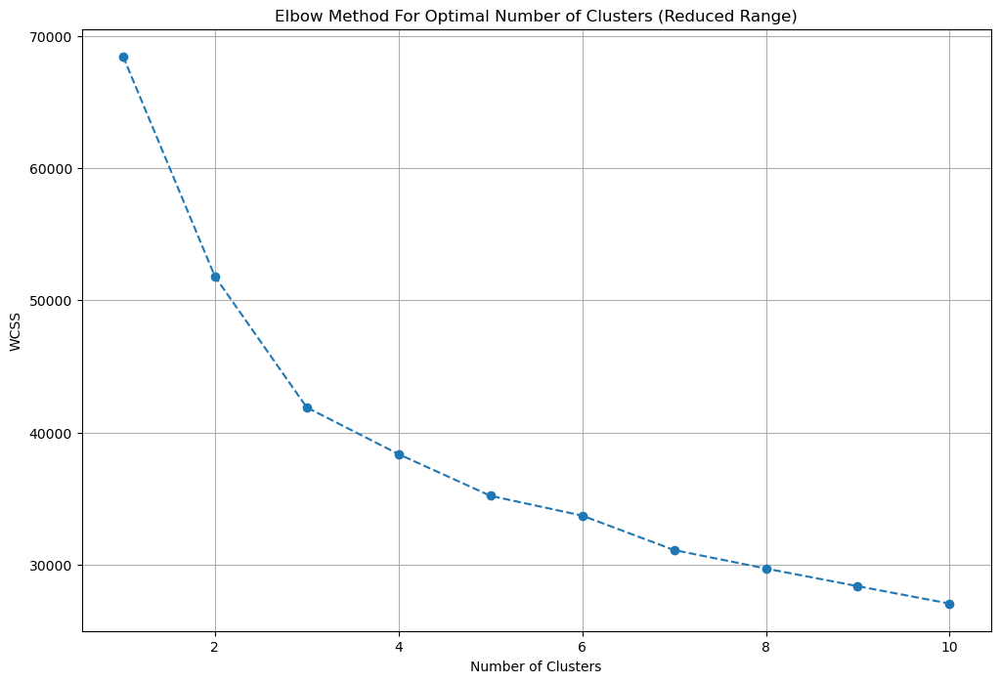

In [232]:
# Plot the results
plt.figure(figsize=(12, 8))
plt.plot(range(1,11), wcss_reduced, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [233]:
n_clusters = 3

# Fit the KMeans model
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(scaled_data)

# Predict the cluster assignments for each row
cluster_assignments = kmeans.predict(scaled_data)

/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [234]:
df = df.iloc[:,:-18]

In [235]:
df['furnishing_type'] = cluster_assignments

In [236]:
df.sample(5)[['furnishDetails','furnishing_type']]
# 0 -> unfurnished
# 1 -> semifurnished
# 2 -> furnished

,furnishDetails,furnishing_type
502,"['5 Wardrobe', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",0
3327,"['5 AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0
2006,"['1 Chimney', '1 Modular Kitchen', 'No AC', 'No Bed', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0
405,"['4 Wardrobe', '6 Fan', '1 Exhaust Fan', '3 Geyser', '1 Microwave', '10 Light', '4 AC', '1 Chimney', '1 Curtains', 'No Bed', 'No Dining Table', 'No Modular Kitchen', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",2
1955,NaN,0


Description:-
- In the details related to furnishing, encounter either "NaN" values or a substantial amount of information in the form of a "Python List." 
- Creating separate columns for each category is impractical as not all categories are relevant for future analysis, and some categories might exhibit correlations.

- To address this, I have chosen to categorize the data into three columns: "furnished," "semi-furnished," and "unfurnished." 
- However, determining how much information is indicative of a flat being categorized as furnished, semi-furnished, or unfurnished poses a challenge.

- To tackle this, I employed a clustering approach. 
- Initially, I divided the data into 18 unique categories and filled in the information. 
- Subsequently, I applied "k-means clustering" and, based on the "elbow method," decided to organize the data into 3 clusters. 
- In this clustering, "1" represents "semi-furnished," "0" corresponds to "unfurnished," and "2" signifies the "furnished" category.    


# 5. Features

In [237]:
df['features'].value_counts()

features
['Feng Shui / Vaastu Compliant', 'Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Park', 'Visitor Parking']                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              290
['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for ser

In [238]:
df[['society','features']].sample(5)

,society,features
3338,parsvnath exotica,"['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
1719,paras dews,"['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
3724,independent,"['Feng Shui / Vaastu Compliant', 'Visitor Parking']"
1756,central park flower valley,NaN
96,independent,"['Water Storage', 'Park', 'Piped-gas', 'Visitor Parking', 'Club house / Community Center']"


In [239]:
df['features'].isnull().sum()

635

- Within the "amenities" column, details related to amenities are provided alongside flat information. 
- A total of "635" missing values were identified in this column. 
- To address this, I utilized another CSV file named "apartments," which contains amenity details.
- I uploaded the "apartments" data and converted the values to lowercase, aligning with the lowercase format used in the "flats" CSV file. 
- This allows for consistent processing and filling of amenity details.

In [240]:
import pandas as pd
app_df = pd.read_csv('appartments.csv')
app_df.head(2)

,PropertyName,PropertySubName,NearbyLocations,LocationAdvantages,Link,PriceDetails,TopFacilities
0,Smartworld One DXP,"2, 3, 4 BHK Apartment in Sector 113, Gurgaon","['Bajghera Road', 'Palam Vihar Halt', 'DPSG Palam Vihar', 'Park Hospital', 'Gurgaon Railway Station']","{'Bajghera Road': '800 Meter', 'Palam Vihar Halt': '2.5 KM', 'DPSG Palam Vihar': '3.1 KM', 'Park Hospital': '3.1 KM', 'Gurgaon Railway Station': '4.9 KM', 'The NorthCap University': '5.4 KM', 'Dwarka Expy': '1.2 KM', 'Hyatt Place Gurgaon Udyog Vihar': '7.7 KM', 'Dwarka Sector 21, Metro Station': '7.2 KM', 'Pacific D21 Mall': '7.4 KM', 'Indira Gandhi International Airport': '14.7 KM', 'Hamoni Golf Camp': '6.2 KM', 'Fun N Food Waterpark': '8.8 KM', 'Accenture DDC5': '9 KM'}",https://www.99acres.com/smartworld-one-dxp-sector-113-gurgaon-npxid-r400415,"{'2 BHK': {'building_type': 'Apartment', 'area_type': 'Carpet Area', 'area': '1,370 sq.ft.', 'price-range': '₹ 2 - 2.4 Cr'}, '3 BHK': {'building_type': 'Apartment', 'area_type': 'Carpet Area', 'area': '1,850 - 2,050 sq.ft.', 'price-range': '₹ 2.25 - 3.59 Cr'}, '4 BHK': {'building_type': 'Apartment', 'area_type': 'Carpet Area', 'area': '2,600 sq.ft.', 'price-range': '₹ 3.24 - 4.56 Cr'}}","['Swimming Pool', 'Salon', 'Restaurant', 'Spa', 'Cafeteria', 'Sun Deck', '24x7 Security', 'Club House', 'Gated Community']"
1,M3M Crown,"3, 4 BHK Apartment in Sector 111, Gurgaon","['DPSG Palam Vihar Gurugram', 'The NorthCap University', 'Park Hospital, Palam Vihar', 'Pacific D21 Mall', 'Palam Vihar Halt Railway Station']","{'DPSG Palam Vihar Gurugram': '1.4 Km', 'The NorthCap University': '4.4 Km', 'Park Hospital, Palam Vihar': '1.4 Km', 'Pacific D21 Mall': '8.2 Km', 'Palam Vihar Halt Railway Station': '1.2 Km', 'Dwarka Sector 21 Metro Station': '8.1 Km', 'Dwarka Expressway': '450 m', 'Fun N Food Water Park': '8.1 Km', 'Indira Gandhi International Airport': '14.1 Km', 'Tau DeviLal Sports Complex': '11.2 Km', 'Hamoni Golf Camp': '5 Km', 'Hyatt Place': '6.1 Km', 'Altrade Business Centre': '11.2 Km'}",https://www.99acres.com/m3m-crown-sector-111-gurgaon-npxid-r404068,"{'3 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '1,605 - 2,170 sq.ft.', 'price-range': '₹ 2.2 - 3.03 Cr'}, '4 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '2,248 - 2,670 sq.ft.', 'price-range': '₹ 3.08 - 3.73 Cr'}}","['Bowling Alley', 'Mini Theatre', 'Manicured Garden', 'Swimming Pool', 'Flower Garden', 'Reading Lounge', 'Golf Course', 'Barbecue', 'Sauna']"


In [241]:
app_df['PropertyName'] = app_df['PropertyName'].str.lower()

In [242]:
# creating temporary data frame to save features missing value

temp_df = df[df['features'].isnull()]

In [243]:
temp_df.head()

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,pooja room,others,furnishing_type
3,house,independent,sector 12,1.40,8702.0,1609.0,Plot area 166(138.8 sq.m.),2,2,1,not available,2.0,North-East,Old Property,"['Ravi Clinic and Health Care Centre', 'D.R. Rajnis Gupta Clinic', 'Geeta Nursing Home Gurgaon', 'Bindal Clinic', 'Aryan Hospital', 'Bhatnagar Maternity and Nursing Home', 'Sparsh Hospital Gurgaon', 'M.S Hospital', 'Triveni Hospital Gurgaon', 'My Care Clinic', 'Chiranjiv Hospital', 'Dr. Sarvejeet Singh', 'Centre For Sight Gurgaon New Railway Road', 'Kidney Clinic', 'Kharbanda Maternity and Nursing Home', 'Swastik Maternity and Medical Centre', 'Dentecare - Multispeciality Dental Clinic', 'Lalit Dental Care', 'Lall Eye Care Centre', 'Om Charitable Dental & Implant Centre', 'Lall Nursing and Maternity Home', 'M Goel Hospital', 'Gupta Hospital Gurgaon', 'Dr. Ajay S. Gupta Clinic', 'Dental Health Centre', 'Verma E.N.T. Hospital', 'Nova Care Clinic', 'Jackson Hospital', 'Dev Man Kathuria Clinic', 'Dr. Madan Clinic', 'Taneja Hospital', 'Dr. Agya Ram Sharma Clinic', 'Satyam Hospital Gurgaon', 'Gurgaon Eye Centre', 'Pearl Dental Clinic', 'Rajiv Memorial Eye Infirmary Jacobpura', 'Sharma Hospital Gurgaon', 'GH Gurgaon', 'Dr. Ashok Jain', 'Ahooja Eye and Dental Institute Hospital', 'Dr. Sandeep Chauhan', 'Tirath Ram Hospitals Pvt Ltd', 'Shri Gobind Hospital', 'Lal Superspeciality Hospital', 'Pasricha Hospital and Maternity Home', 'Shubham Hospital Gurgaon', 'State bank of india', 'Rang Parivartan', 'Dronacharya Government College', 'St. Michaels Sr. Sec. School']",NaN,NaN,NaN,166.0,NaN,0,0,0,0,0,0
11,flat,m3m heights,sector 65,2.86,14000.0,2043.0,Carpet area: 2040 (189.52 sq.m.),3,3,3,servant room,45.0,East,Under Construction,"['Rapid Metro Sector 56', 'M3m 65th Avenue Mall', 'Golf Course Extension Road', 'Gurgaon - Delhi Expy', 'DPS International School', 'DPG Institute of Technology', 'Park Hospital', 'Indira Gandhi International Airport', 'Lemon Tree Hotel', 'SkyJumper Trampoline Park', 'PVR Drive in Theatre']",[],NaN,NaN,NaN,2040.0,0,1,0,0,0,0
27,house,vatika sovereign next,sector 82a,3.85,7500.0,5133.0,Built Up area: 5140 (477.52 sq.m.),5,6,3+,not available,6.0,NaN,Undefined,"['Orris Community Center', 'Petrol Pump Indian Oil', 'Petrol Pump', 'Petrol Pump Indian Oil', 'Petrol pump Maitri motors', 'Rao Dhaba', ""McDonald's"", 'KFC', 'Pizza Hut', ""McDonald's"", 'Haldiram']","['1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",NaN,NaN,5140.0,NaN,0,0,0,0,0,0
29,house,independent,sohna road road,0.50,5555.0,900.0,Plot area 900(83.61 sq.m.),2,1,2,not available,1.0,NaN,Moderately Old,"['Rajiv Chowk Mosque', 'Standard chartered ATM', 'Icici bank ATM', 'Samvit Health Care', ""DR AKRAM JAWED'S THE UPPER LIMB CLINIC"", 'Medanta', 'Sukhmani Hospital Pvt. Ltd', 'Airforce Hospital', 'Park Hospital Gurgaon', 'Vishesh Dental', 'Neelkanth Health Care', 'Best Urologist Atcomplete Family Clinic', 'Wellness Eye Centre', 'Dr. Aruna Kalra', 'Bansal Medicare and Maternity Centre', 'Meher Clinic', 'Pushpanjali Hospital Gurgaon', 'Dispencery', 'Dr. Anuj Sharma', 'Dr. Naresh Pandita', 'Pushpanjali Hospital', 'Bones Clinic - Orthopaedics', 'Smile Plus Dental Clinic', 'Vaishnavi Nursing Home', 'Skin Clinic', 'Rajendra Hospital', 'Road and Traffic Authority', 'Gurgaon Election Commission', 'Apollo Pharmacy', 'Gardian Pharmacy', 'Genius', 'India Oil', 'SRS Cinemas', 'SRS Cinemas', 'Hdfc bank', 'Icici bank', 'Hdfc bank', 'KFC', 'Haldiram', ""Domino's Pizza"", 'Darbar', ""Nirula's"", 'Kendriya Vidyalaya No.2 Sohna Road', 'Delhi Public School Pri

In [244]:
temp_df.shape

(635, 26)

In [245]:
temp_df.merge(app_df,left_on='society', right_on='PropertyName', how='left')[['features','TopFacilities']]

,features,TopFacilities
0,NaN,NaN
1,NaN,"['Bus Shelter', 'Infinity Pool', 'Swimming Pool', 'Bar/Chill-Out Lounge', 'Reflexology Park', 'Aerobics Centre', 'Restaurant', 'Terrace Garden', 'High Speed Elevators']"
2,NaN,"['Swimming Pool', 'Barbecue', 'Pergola', 'Sauna', 'Steam Room', 'Gazebo', 'Property Staff', 'Sun Deck', 'Earthquake Resistant']"
3,NaN,NaN
4,NaN,NaN
5,NaN,NaN
6,NaN,NaN
7,NaN,NaN
8,NaN,"['Swimming Pool', 'Football', 'Bar/Chill-Out Lounge', 'Medical Centre', 'Reading Lounge', 'School', 'Solar Lighting', 'Aerobics Centre', 'Card Room']"
9,NaN,NaN


In [246]:
x = temp_df.merge(app_df,left_on='society', right_on='PropertyName', how='left')['TopFacilities']
# extracted "TopFacilities" column data and placed in variable "x"

In [247]:
df.loc[temp_df.index, 'features']=x.values
# now uploaded x values in original df

In [248]:
df['features'].isnull().sum()
# so far fill 154 values (635-481) in features column.

481

 deeper analysis:-
- I found that there are a total of 130 distinct amenities in the features dataset. 
- To better represent this information, individual columns will be generated for each amenity in a binary format, where a value of 1 indicates its presence, and 0 denotes its absence.
 Following this, the features will be grouped into categories such as luxury flats, semi-luxury flats, or budget flats based on clustering.

In [249]:
from sklearn.preprocessing import MultiLabelBinarizer
import ast

In [250]:
# Convert the string representation of lists in the 'features' column to actual lists
df['features_list'] = df['features'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) and x.startswith('[') else [])

# Use MultiLabelBinarizer to convert the features list into a binary matrix
mlb = MultiLabelBinarizer()
features_binary_matrix = mlb.fit_transform(df['features_list'])

# Convert the binary matrix into a DataFrame
features_binary_df = pd.DataFrame(features_binary_matrix, columns=mlb.classes_)

In [251]:
features_binary_df.sample(5)

,24/7 Power Backup,24/7 Water Supply,24x7 Security,ATM,Aerobics Centre,Air Hockey,Airy Rooms,Amphitheatre,Automated Car Wash,Badminton Court,Bank Attached Property,Banquet Hall,Bar/Chill-Out Lounge,Barbecue,Basketball Court,Beach Volley Ball Court,Billiards,Bowling Alley,Bus Shelter,Business Lounge,CCTV Camera Security,Cafeteria,Car Parking,Car wash area,Card Room,Centrally Air Conditioned,Changing Area,Children's Play Area,Cigar Lounge,Clinic,Club House,Club house / Community Center,Community Hall,Concierge Service,Conference room,Creche/Day care,Cricket Pitch,Doctor on Call,Earthquake Resistant,Entrance Lobby,False Ceiling Lighting,Feng Shui / Vaastu Compliant,Fire Fighting Systems,Fitness Centre / GYM,Flower Garden,Food Court,Foosball,Football,Fountain,Gated Community,Gazebo,Golf Course,Grocery Shop,Gymnasium,High Ceiling Height,High Speed Elevators,Infinity Pool,Intercom Facility,Internal Street Lights,Internet/wi-fi connectivity,Jacuzzi,Jogging Track,Landscape Garden,Laundry,Lawn Tennis Court,Library,Lift(s),Lounge,Low Density Society,Maintenance Staff,Manicured Garden,Medical Centre,Milk Booth,Mini Theatre,Multipurpose Court,Multipurpose Hall,Natural Light,Natural Pond,No open drainage around,Park,Party Lawn,Pergola,Piped Gas,Piped-gas,Pool Table,Power Back up Lift,Power Back-up,Private Garden / Terrace,Property Staff,RO System,Rain Water Harvesting,Reading Lounge,Recently Renovated,Reflexology Park,Restaurant,Salon,Sauna,School,Security / Fire Alarm,Security Personnel,Separate entry for servant room,Sewage Treatment Plant,Shopping Centre,Skating Rink,Solar Lighting,Solar Water Heating,Spa,Spacious Interiors,Squash Court,Steam Room,Sun Deck,Swimming Pool,Temple,Terrace Garden,Theatre,Toddler Pool,Valet Parking,Vastu Compliant,Video Door Security,Visitor Parking,Visitors Parking,Volley Ball Court,Waiting Lounge,Waste Disposal,Water Softener Plant,Water Storage,Water purifier,Water softening plant,Wi-Fi Connectivity,Yoga/Meditation Area
1140,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,0,0,1,1,0,0,1,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,1,0,0
909,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0
2048,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1036,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
439,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0


In [252]:
features_binary_df.shape

(3803, 130)

In [253]:
# applied K means clustering

wcss_reduced = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(features_binary_df)
    wcss_reduced.append(kmeans.inertia_)

/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/nimishasingh/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of

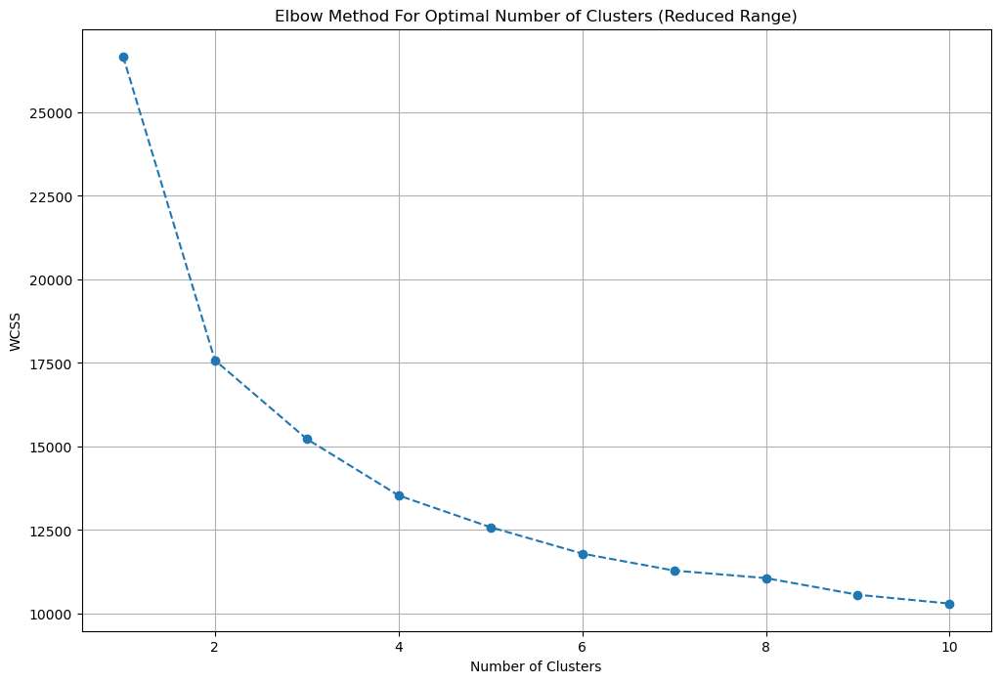

In [254]:
# Plot the results
plt.figure(figsize=(12, 8))
plt.plot(range(1,11), wcss_reduced, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

- so as per "elbow method" we should go with "2 cluster" which is "Luxury" & "Budget" flats.
 

- it is dividing where feature is null values in budget flats and with feature flat as luxury.
- so I decided to create score based on amenties and sum up them ,based on number of amenties score flat score will decide.

In [256]:
# Define the weights for each feature as provided
# Assigning weights based on perceived luxury contribution

weights = {
    '24/7 Power Backup': 8,
    '24/7 Water Supply': 4,
    '24x7 Security': 7,
    'ATM': 4,
    'Aerobics Centre': 6,
    'Airy Rooms': 8,
    'Amphitheatre': 7,
    'Badminton Court': 7,
    'Banquet Hall': 8,
    'Bar/Chill-Out Lounge': 9,
    'Barbecue': 7,
    'Basketball Court': 7,
    'Billiards': 7,
    'Bowling Alley': 8,
    'Business Lounge': 9,
    'CCTV Camera Security': 8,
    'Cafeteria': 6,
    'Car Parking': 6,
    'Card Room': 6,
    'Centrally Air Conditioned': 9,
    'Changing Area': 6,
    "Children's Play Area": 7,
    'Cigar Lounge': 9,
    'Clinic': 5,
    'Club House': 9,
    'Concierge Service': 9,
    'Conference room': 8,
    'Creche/Day care': 7,
    'Cricket Pitch': 7,
    'Doctor on Call': 6,
    'Earthquake Resistant': 5,
    'Entrance Lobby': 7,
    'False Ceiling Lighting': 6,
    'Feng Shui / Vaastu Compliant': 5,
    'Fire Fighting Systems': 8,
    'Fitness Centre / GYM': 8,
    'Flower Garden': 7,
    'Food Court': 6,
    'Foosball': 5,
    'Football': 7,
    'Fountain': 7,
    'Gated Community': 7,
    'Golf Course': 10,
    'Grocery Shop': 6,
    'Gymnasium': 8,
    'High Ceiling Height': 8,
    'High Speed Elevators': 8,
    'Infinity Pool': 9,
    'Intercom Facility': 7,
    'Internal Street Lights': 6,
    'Internet/wi-fi connectivity': 7,
    'Jacuzzi': 9,
    'Jogging Track': 7,
    'Landscape Garden': 8,
    'Laundry': 6,
    'Lawn Tennis Court': 8,
    'Library': 8,
    'Lounge': 8,
    'Low Density Society': 7,
    'Maintenance Staff': 6,
    'Manicured Garden': 7,
    'Medical Centre': 5,
    'Milk Booth': 4,
    'Mini Theatre': 9,
    'Multipurpose Court': 7,
    'Multipurpose Hall': 7,
    'Natural Light': 8,
    'Natural Pond': 7,
    'Park': 8,
    'Party Lawn': 8,
    'Piped Gas': 7,
    'Pool Table': 7,
    'Power Back up Lift': 8,
    'Private Garden / Terrace': 9,
    'Property Staff': 7,
    'RO System': 7,
    'Rain Water Harvesting': 7,
    'Reading Lounge': 8,
    'Restaurant': 8,
    'Salon': 8,
    'Sauna': 9,
    'Security / Fire Alarm': 9,
    'Security Personnel': 9,
    'Separate entry for servant room': 8,
    'Sewage Treatment Plant': 6,
    'Shopping Centre': 7,
    'Skating Rink': 7,
    'Solar Lighting': 6,
    'Solar Water Heating': 7,
    'Spa': 9,
    'Spacious Interiors': 9,
    'Squash Court': 8,
    'Steam Room': 9,
    'Sun Deck': 8,
    'Swimming Pool': 8,
    'Temple': 5,
    'Theatre': 9,
    'Toddler Pool': 7,
    'Valet Parking': 9,
    'Video Door Security': 9,
    'Visitor Parking': 7,
    'Water Softener Plant': 7,
    'Water Storage': 7,
    'Water purifier': 7,
    'Yoga/Meditation Area': 7
}



In [257]:
# Calculate luxury score for each row
luxury_score = features_binary_df[list(weights.keys())].multiply(list(weights.values())).sum(axis=1)

In [258]:
df['luxury_score'] = luxury_score

In [259]:
df.head()

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,pooja room,others,furnishing_type,features_list,luxury_score
0,flat,la vida by tata housing,sector 113,3.05,15561.0,1960.0,Super Built up area 2690(249.91 sq.m.)Built Up area: 2150 sq.ft. (199.74 sq.m.)Carpet area: 1960 sq.ft. (182.09 sq.m.),3,4,3,servant room,3.0,North-West,Relatively New,"['Dwarka Sector 21', 'Pacific D21 Mall', 'Bajghera Road', 'Dwarka Expy', 'Euro International School, Sector- 109.', 'The NorthCap University', ""Rion's Hospital"", 'Indira Gandhi Intl Airport', 'Bijwasan Railway Station']","['1 Geyser', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2690.0,2150.0,1960.0,0,1,0,0,0,0,"[Centrally Air Conditioned, Water purifier, Security / Fire Alarm, Feng Shui / Vaastu Compliant, Private Garden / Terrace, Intercom Facility, Lift(s), High Ceiling Height, Maintenance Staff, False Ceiling Lighting, Water Storage, Separate entry for servant room, No open drainage around, Bank Attached Property, Piped-gas, Internet/wi-fi connectivity, Recently Renovated, Visitor Parking, Swimming Pool, Park, Security Personnel, Natural Light, Airy Rooms, Spacious Interiors, Low Density Society, Waste Disposal, Rain Water Harvesting, Water softening plant, Shopping Centre, Fitness Centre / GYM, Club house / Community Center]",174
1,flat,m3m woodshire,sector 107,0.88,6442.0,1366.0,Super Built up area 1366(126.91 sq.m.),2,2,3+,not available,3.0,East,Relatively New,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']","['1 Bed', '5 Fan', '1 Sofa', '10 Light', '3 AC', '1 Curtains', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'No open drainage around', 'Recently Renovated', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1366.0,NaN,NaN,0,0,0,0,0,0,"[Intercom Facility, Lift(s), Maintenance Staff, No open drainage around, Recently Renovated, Swimming Pool, Park, Security Personnel, Natural Light, Internet/wi-fi connectivity, Airy Rooms, Spacious Interiors, Low Density Society, Shopping Centre, Fitness Centre / GYM, Rain Water Harvesting, Club house / Community Center, Water softening plant]",99
2,house,vatika india next,sector 82,7.00,194444.0,360.0,Plot area 360(33.45 sq.m.)Built Up area: 3900 sq.ft. (362.32 sq.m.)Carpet area: 3743 sq.ft. (347.74 sq.m.),4,4,3+,servant room,3.0,North-East,Relatively New,"['Sapphire 83 Mall', 'Dwarka expressway', 'Delhi Public Sc

In [260]:
# cols to drop -> nearbyLocations,furnishDetails, features,features_list, additionalRoom
df.drop(columns=['nearbyLocations','furnishDetails','features','features_list','additionalRoom'],inplace=True)

In [261]:
df.sample(5)

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,pooja room,others,furnishing_type,luxury_score
3607,flat,cancon enclave,sector 4,1.05,7777.0,1350.0,Carpet area: 1350 (125.42 sq.m.),3,2,2,2.0,NaN,New Property,NaN,NaN,1350.0,0,0,0,0,0,2,0
2411,flat,emaar mgf emerald floors premier,sector 65,2.24,13575.0,1650.0,Carpet area: 1650 (153.29 sq.m.),3,3,3,2.0,North-West,Relatively New,NaN,NaN,1650.0,1,1,0,0,0,0,46
440,flat,eldeco accolade,sohna road,0.95,6542.0,1452.0,Super Built up area 1452(134.9 sq.m.)Carpet area: 849 sq.ft. (78.87 sq.m.),2,2,3+,6.0,East,New Property,1452.0,NaN,849.0,1,0,0,0,0,2,56
337,flat,m3m skycity,sector 65,2.80,15317.0,1828.0,Built Up area: 1828 (169.83 sq.m.),3,3,0,14.0,NaN,Undefined,NaN,1828.0,NaN,0,0,0,0,0,0,39
2855,flat,orchid island,sector 51,0.71,7891.0,900.0,Carpet area: 906 (84.17 sq.m.),2,2,1,4.0,NaN,Relatively New,NaN,NaN,906.0,0,0,0,0,0,0,23


In [262]:
df.shape

(3803, 23)

In [263]:
df.to_csv('gurgaon_properties_cleaned_v2.csv',index=False)